In [107]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os 
import networkx as nx
from copy import deepcopy
import queue
import math
import csv
from datetime import datetime
from numpy import linalg as LA
#from numpy.linalg import eig
from urllib.request import urlopen
import json
import plotly.graph_objects as go
import plotly.express as px
import seaborn as sns
#os.chdir("/Users/ransun/Dropbox/MAC_DROPBOX_CLOUD/Datasets/Chicago")
os.chdir("/Volumes/Seagate Bac/ResearchData/ChicagoData/TNC_UpdatedMay272020")
from scipy import stats
# Load the required packages
import dask
import time
import psutil
import numpy as np
import pandas as pd
import multiprocessing as mp

# Check the number of cores and memory usage
num_cores = mp.cpu_count()
print("This kernel has ",num_cores,"cores and you can find the information regarding the memory usage:",psutil.virtual_memory())


This kernel has  16 cores and you can find the information regarding the memory usage: svmem(total=17179869184, available=6980677632, percent=59.4, used=10092752896, free=134062080, active=6845730816, inactive=6748565504, wired=3247022080)


In [2]:
! pwd

/Volumes/Seagate Bac/ResearchData/ChicagoData/TNC_UpdatedMay272020


In [3]:
! ls

ODTime_2020Jan.csv
ODTime_2020Jan_sort.csv
TNC_2018.csv
TNC_2019.csv
TNC_2020.csv
TNC_2020_Jan_Tiger.csv
TNC_Datetime.csv
Transportation Network Providers - Trips _ City of Chicago _ Data Portal.pdf
Transportation_Network_Providers_-_Trips.csv


# ----------------------------------------
# ----------------------------------------
# load TNC Data and seperate them based on year
# ----------------------------------------
# ----------------------------------------

In [12]:
# load TNC data (up to 05272020)
# https://data.cityofchicago.org/Transportation/Transportation-Network-Providers-Trips/m6dm-c72p

TNC = pd.read_csv('Transportation_Network_Providers_-_Trips.csv')

In [13]:
TNC.head()

,Trip ID,Trip Start Timestamp,Trip End Timestamp,Trip Seconds,Trip Miles,Pickup Census Tract,Dropoff Census Tract,Pickup Community Area,Dropoff Community Area,Fare,...,Additional Charges,Trip Total,Shared Trip Authorized,Trips Pooled,Pickup Centroid Latitude,Pickup Centroid Longitude,Pickup Centroid Location,Dropoff Centroid Latitude,Dropoff Centroid Longitude,Dropoff Centroid Location
0,9448f7392b1afe86546a34a1c2728d7dd7b22cf8,01/10/2019 07:00:00 PM,01/10/2019 07:15:00 PM,216.0,1.3,1.703184e+10,1.703140e+10,37.0,40.0,5.0,...,2.55,7.55,False,1,41.801823,-87.632245,POINT (-87.632245255 41.8018227527),41.782863,-87.620558,POINT (-87.6205583422 41.7828634535)
1,9448f8041e5f7a519615ad6b607e1fee22c74e4a,01/16/2019 10:00:00 AM,01/16/2019 10:00:00 AM,393.0,1.1,NaN,NaN,61.0,67.0,5.0,...,2.55,7.55,False,1,41.809018,-87.659167,POINT (-87.6591665992 41.8090182499),41.775929,-87.666596,POINT (-87.6665962653 41.7759288274)
2,9448f8284ed1d3bbbf43c67e72e0b3c1af74d43c,12/24/2018 11:45:00 AM,12/24/2018 12:15:00 PM,1672.0,7.7,NaN,NaN,73.0,NaN,17.5,...,0.00,17.50,True,1,41.717493,-87.648895,POINT (-87.6488950721 41.7174930361),NaN,NaN,NaN
3,9448f86d3a8bf7c4a036d7d9ab3c62130db98fea,11/17/2018 09:45:00 AM,11/17/2018 10:15:00 AM,1462.0,12.4,1.703132e+10,1.703198e+10,32.0,56.0,20.0,...,7.50,27.50,False,1,41.877406,-87.621972,POINT (-87.6219716519 41.8774061234),41.785999,-87.750934,POINT (-87.7509342894 41.785998518)
4,9448f907767b8ac023032fcbaef5012b8776c293,12/12/2018 12:30:00 AM,12/12/2018 01:00:00 AM,1188.0,12.3,NaN,NaN,76.0,NaN,15.0,...,7.88,22.88,False,1,41.980264,-87.913625,POINT (-87.913624596 41.9802643146),NaN,NaN,NaN


In [14]:
TNC.shape

(152496604, 21)

In [15]:
TNC.describe()

,Trip Seconds,Trip Miles,Pickup Census Tract,Dropoff Census Tract,Pickup Community Area,Dropoff Community Area,Fare,Tip,Additional Charges,Trip Total,Trips Pooled,Pickup Centroid Latitude,Pickup Centroid Longitude,Dropoff Centroid Latitude,Dropoff Centroid Longitude
count,1.522826e+08,1.524916e+08,1.085322e+08,1.078726e+08,1.428608e+08,1.416806e+08,1.524965e+08,1.524966e+08,1.524965e+08,1.524965e+08,1.524966e+08,1.429866e+08,1.429866e+08,1.418040e+08,1.418040e+08
mean,1.081895e+03,6.245117e+00,1.703137e+10,1.703138e+10,2.573844e+01,2.633880e+01,1.169570e+01,6.189213e-01,3.048792e+00,1.536341e+01,1.225325e+00,4.189234e+01,-8.766702e+01,4.189303e+01,-8.766885e+01
std,7.785476e+02,6.971114e+00,3.360550e+05,3.403973e+05,2.047321e+01,2.083148e+01,9.704414e+00,1.726706e+00,2.010846e+00,1.149964e+01,9.414350e-01,6.164690e-02,6.260317e-02,6.172080e-02,6.618655e-02
min,0.000000e+00,0.000000e+00,1.703101e+10,1.703101e+10,1.000000e+00,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.000000e+00,4.165022e+01,-8.791362e+01,4.165022e+01,-8.791362e+01
25%,5.400000e+02,1.800000e+00,1.703108e+10,1.703108e+10,8.000000e+00,8.000000e+00,5.000000e+00,0.000000e+00,2.550000e+00,8.000000e+00,1.000000e+00,4.187741e+01,-8.768098e+01,4.187741e+01,-8.768364e+01
50%,8.730000e+02,3.800000e+00,1.703124e+10,1.703124e+10,2.400000e+01,2.400000e+01,7.500000e+00,0.000000e+00,2.550000e+00,1.250000e+01,1.000000e+00,4.189322e+01,-8.765197e+01,4.189322e+01,-8.765177e+01
75%,1.402000e+03,7.800000e+00,1.703183e+10,1.703183e+10,3.200000e+01,3.200000e+01,1.500000e+01,0.000000e+00,2.800000e+00,1.755000e+01,1.000000e+00,4.192908e+01,-8.763172e+01,4.192933e+01,-8.763172e+01
max,8.613000e+04,8.416000e+02,1.703198e+10,1.703198e+10,7.700000e+01,7.700000e+01,1.400000e+03,2.000000e+02,9.713000e+01,1.402050e+03,4.097000e+03,4.202122e+01,-8.752995e+01,4.202122e+01,-8.752995e+01


In [16]:
TNC_Analysis = TNC.copy()

In [17]:
TNC_Analysis['Trip Start Timestamp'][0]

'01/10/2019 07:00:00 PM'

In [18]:
pd.to_datetime('01/10/2019 07:00:00 PM',format = '%m/%d/%Y %I:%M:%S %p')

Timestamp('2019-01-10 19:00:00')

In [19]:
TNC_Analysis['Trip Start Timestamp'] = pd.to_datetime(TNC['Trip Start Timestamp'],format = '%m/%d/%Y %I:%M:%S %p')

In [20]:
TNC_Analysis['Trip Start Timestamp'][0]

Timestamp('2019-01-10 19:00:00')

In [21]:
TNC_Analysis['Trip End Timestamp'] = pd.to_datetime(TNC['Trip End Timestamp'],format = '%m/%d/%Y %I:%M:%S %p')

In [22]:
TNC_Analysis['Trip End Timestamp'][0]

Timestamp('2019-01-10 19:15:00')

In [23]:
TNC_Analysis['Trip Start Timestamp'].dt.month

0             1
1             1
2            12
3            11
4            12
             ..
152496599     1
152496600     3
152496601     1
152496602     1
152496603    12
Name: Trip Start Timestamp, Length: 152496604, dtype: int64

In [24]:
TNC_Analysis['TripStartMonth'] = TNC_Analysis['Trip Start Timestamp'].dt.month
TNC_Analysis['TripStartDay'] =TNC_Analysis['Trip Start Timestamp'].dt.day
TNC_Analysis['TripStartYear'] =TNC_Analysis['Trip Start Timestamp'].dt.year
TNC_Analysis['TripStartHour'] =TNC_Analysis['Trip Start Timestamp'].dt.hour
TNC_Analysis['TripStartMin'] =TNC_Analysis['Trip Start Timestamp'].dt.minute

TNC_Analysis['TripEndMonth'] = TNC_Analysis['Trip End Timestamp'].dt.month
TNC_Analysis['TripEndDay'] =TNC_Analysis['Trip End Timestamp'].dt.day
TNC_Analysis['TripEndYear'] =TNC_Analysis['Trip End Timestamp'].dt.year
TNC_Analysis['TripEndHour'] =TNC_Analysis['Trip End Timestamp'].dt.hour
TNC_Analysis['TripEndMin'] =TNC_Analysis['Trip End Timestamp'].dt.minute

In [25]:
TNC_Analysis.head()

,Trip ID,Trip Start Timestamp,Trip End Timestamp,Trip Seconds,Trip Miles,Pickup Census Tract,Dropoff Census Tract,Pickup Community Area,Dropoff Community Area,Fare,...,TripStartMonth,TripStartDay,TripStartYear,TripStartHour,TripStartMin,TripEndMonth,TripEndDay,TripEndYear,TripEndHour,TripEndMin
0,9448f7392b1afe86546a34a1c2728d7dd7b22cf8,2019-01-10 19:00:00,2019-01-10 19:15:00,216.0,1.3,1.703184e+10,1.703140e+10,37.0,40.0,5.0,...,1,10,2019,19,0,1,10,2019,19,15
1,9448f8041e5f7a519615ad6b607e1fee22c74e4a,2019-01-16 10:00:00,2019-01-16 10:00:00,393.0,1.1,NaN,NaN,61.0,67.0,5.0,...,1,16,2019,10,0,1,16,2019,10,0
2,9448f8284ed1d3bbbf43c67e72e0b3c1af74d43c,2018-12-24 11:45:00,2018-12-24 12:15:00,1672.0,7.7,NaN,NaN,73.0,NaN,17.5,...,12,24,2018,11,45,12,24,2018,12,15
3,9448f86d3a8bf7c4a036d7d9ab3c62130db98fea,2018-11-17 09:45:00,2018-11-17 10:15:00,1462.0,12.4,1.703132e+10,1.703198e+10,32.0,56.0,20.0,...,11,17,2018,9,45,11,17,2018,10,15
4,9448f907767b8ac023032fcbaef5012b8776c293,2018-12-12 00:30:00,2018-12-12 01:00:00,1188.0,12.3,NaN,NaN,76.0,NaN,15.0,...,12,12,2018,0,30,12,12,2018,1,0


In [26]:
TNC_Analysis.shape

(152496604, 31)

In [27]:
TNC_Analysis.to_csv('TNC_Datetime.csv',index=False)

# now seperate 'TNC_Datetime' by Year

In [5]:
TNC_Analysis = pd.read_csv('TNC_Datetime.csv')

In [6]:
TNC_Analysis.head()

,Trip ID,Trip Start Timestamp,Trip End Timestamp,Trip Seconds,Trip Miles,Pickup Census Tract,Dropoff Census Tract,Pickup Community Area,Dropoff Community Area,Fare,...,TripStartMonth,TripStartDay,TripStartYear,TripStartHour,TripStartMin,TripEndMonth,TripEndDay,TripEndYear,TripEndHour,TripEndMin
0,9448f7392b1afe86546a34a1c2728d7dd7b22cf8,2019-01-10 19:00:00,2019-01-10 19:15:00,216.0,1.3,1.703184e+10,1.703140e+10,37.0,40.0,5.0,...,1,10,2019,19,0,1,10,2019,19,15
1,9448f8041e5f7a519615ad6b607e1fee22c74e4a,2019-01-16 10:00:00,2019-01-16 10:00:00,393.0,1.1,NaN,NaN,61.0,67.0,5.0,...,1,16,2019,10,0,1,16,2019,10,0
2,9448f8284ed1d3bbbf43c67e72e0b3c1af74d43c,2018-12-24 11:45:00,2018-12-24 12:15:00,1672.0,7.7,NaN,NaN,73.0,NaN,17.5,...,12,24,2018,11,45,12,24,2018,12,15
3,9448f86d3a8bf7c4a036d7d9ab3c62130db98fea,2018-11-17 09:45:00,2018-11-17 10:15:00,1462.0,12.4,1.703132e+10,1.703198e+10,32.0,56.0,20.0,...,11,17,2018,9,45,11,17,2018,10,15
4,9448f907767b8ac023032fcbaef5012b8776c293,2018-12-12 00:30:00,2018-12-12 01:00:00,1188.0,12.3,NaN,NaN,76.0,NaN,15.0,...,12,12,2018,0,30,12,12,2018,1,0


In [7]:
time2018 = datetime(2018,1,1,0,0,1)
time2019 = datetime(2019,1,1,0,0,1)
time2020 = datetime(2020,1,1,0,0,1)
time2021 = datetime(2021,1,1,0,0,1)
TNC_Year2018 = TNC_Analysis[(TNC_Analysis['TripStartYear']== 2018)]
TNC_Year2019 = TNC_Analysis[(TNC_Analysis['TripStartYear']== 2019)]
TNC_Year2020 = TNC_Analysis[(TNC_Analysis['TripStartYear']== 2020)]


In [8]:
TNC_Year2018.shape,TNC_Year2019.shape,TNC_Year2020.shape


((17461453, 31), (111850744, 31), (23184407, 31))

In [9]:
TNC_Year2018.to_csv('TNC_2018.csv',index=False)
TNC_Year2019.to_csv('TNC_2019.csv',index=False)
TNC_Year2020.to_csv('TNC_2020.csv',index=False)

# ----------------------------------------
# Census Tract
# ----------------------------------------

In [12]:
print(len(TNC_Analysis['Pickup Census Tract'].unique()),len(TNC_Year2018['Pickup Census Tract'].unique()))
print(len(TNC_Year2019['Pickup Census Tract'].unique()),len(TNC_Year2020['Pickup Census Tract'].unique()))

1145 968
1129 1042


## total CT used for pick up 1145
* 2018 - 968
* 2019 - 1129
* 2020 - 1042

In [4]:
# now we look at tiger CT
os.chdir("/Volumes/Seagate Bac/ResearchData/ChicagoData")

In [5]:
! ls

Bike_Racks.csv
Boundaries - Community Areas (current).geojson
Boundaries - Community Areas (current).zip
Chicago_Street_Names.csv
Chicago_Traffic_Tracker_-_Historical_Congestion_Estimates_by_Segment_-_2018-Current.csv
Divvy_Bicycle_Stations_-_All_-_Map.csv
Divvy_Bicycle_Stations_-_In_Service_-_Map.csv
Divvy_Trips.csv
Divvy_Trips_-_Non-Subscriber-Only.csv
Divvy_Trips_-_Subscriber-Only.csv
Map_-_Speed_Camera_Locations.csv
Map_of_the_Community_Areas.png
ODTime_2020Jan.csv
Public_Passenger_Vehicle_Licenses.csv
Speed_Camera_Violations.csv
Street Center Lines.geojson
Street Center Lines.zip
TAZzones17.zip
TNC_UpdatedMay272020
Taxi_UpdatedJuly082020
Towed_Vehicles.csv
Transportation_Network_Providers_-_Drivers.csv
Transportation_Network_Providers_-_Trips.csv
Transportation_Network_Providers_-_Vehicles.csv
censustract


In [6]:
CT = pd.read_csv('censustract/CensusTractsTIGER2010.csv')
CT.head()

,the_geom,STATEFP10,COUNTYFP10,TRACTCE10,GEOID10,NAME10,NAMELSAD10,COMMAREA,COMMAREA_N,NOTES
0,MULTIPOLYGON (((-87.62404799998049 41.73021699...,17,31,842400,17031842400,8424.0,Census Tract 8424,44,44,NaN
1,MULTIPOLYGON (((-87.6860799999848 41.822956000...,17,31,840300,17031840300,8403.0,Census Tract 8403,59,59,NaN
2,MULTIPOLYGON (((-87.62934700001182 41.85279700...,17,31,841100,17031841100,8411.0,Census Tract 8411,34,34,NaN
3,MULTIPOLYGON (((-87.68813499997718 41.85569099...,17,31,841200,17031841200,8412.0,Census Tract 8412,31,31,NaN
4,MULTIPOLYGON (((-87.63312200003458 41.87448800...,17,31,839000,17031839000,8390.0,Census Tract 8390,32,32,NaN


In [7]:
CT.shape

(801, 10)

In [8]:
with open('censustract/Boundaries - Census Tracts - 2010.geojson') as response:
     CT_GEO  = json.load(response)

In [9]:
len(CT_GEO['features'])

801

* we know from geojson and tiger that city of Chicago has 801 census tract
* the taxi data uses 'GEOID10' as CT coding

In [12]:
# sort by community area numbering
CT_sort = CT.sort_values(by=['COMMAREA'])
CT_sort['NO'] = np.arange(1,len(CT_GEO['features'])+1)
CT_sort.head()

,the_geom,STATEFP10,COUNTYFP10,TRACTCE10,GEOID10,NAME10,NAMELSAD10,COMMAREA,COMMAREA_N,NOTES,NO
277,MULTIPOLYGON (((-87.65080299995667 41.99848500...,17,31,10400,17031010400,104.00,Census Tract 104,1,1,NaN,1
248,MULTIPOLYGON (((-87.67009100001071 41.99808200...,17,31,830600,17031830600,8306.00,Census Tract 8306,1,1,NaN,2
65,MULTIPOLYGON (((-87.66505999995483 42.01280100...,17,31,10501,17031010501,105.01,Census Tract 105.01,1,1,NaN,3
496,MULTIPOLYGON (((-87.67335799998422 42.01937400...,17,31,10202,17031010202,102.02,Census Tract 102.02,1,1,NaN,4
348,MULTIPOLYGON (((-87.66368000002299 42.01939800...,17,31,10100,17031010100,101.00,Census Tract 101,1,1,NaN,5


In [80]:
# CT_sort = CT_sort.set_index('NO')
# CT_sort.head()

In [13]:
CT_list = CT_sort['GEOID10'].unique()
17031830600 in CT_sort['GEOID10'].unique()

True

# ----------------------------------------
# ----------------------------------------
# EDA
1. Read data
* Match Census Tract

# ----------------------------------------
# ----------------------------------------

# Year 2020

In [14]:
os.chdir("/Volumes/Seagate Bac/ResearchData/ChicagoData/TNC_UpdatedMay272020")

In [19]:
TNC_Year2020 = pd.read_csv('TNC_2020.csv',index_col=False)

In [20]:
TNC_Year2020.columns

Index(['Trip ID', 'Trip Start Timestamp', 'Trip End Timestamp', 'Trip Seconds',
       'Trip Miles', 'Pickup Census Tract', 'Dropoff Census Tract',
       'Pickup Community Area', 'Dropoff Community Area', 'Fare', 'Tip',
       'Additional Charges', 'Trip Total', 'Shared Trip Authorized',
       'Trips Pooled', 'Pickup Centroid Latitude', 'Pickup Centroid Longitude',
       'Pickup Centroid Location', 'Dropoff Centroid Latitude',
       'Dropoff Centroid Longitude', 'Dropoff Centroid Location',
       'TripStartMonth', 'TripStartDay', 'TripStartYear', 'TripStartHour',
       'TripStartMin', 'TripEndMonth', 'TripEndDay', 'TripEndYear',
       'TripEndHour', 'TripEndMin'],
      dtype='object')

In [21]:
TNC_Year2020.head()

,Trip ID,Trip Start Timestamp,Trip End Timestamp,Trip Seconds,Trip Miles,Pickup Census Tract,Dropoff Census Tract,Pickup Community Area,Dropoff Community Area,Fare,...,TripStartMonth,TripStartDay,TripStartYear,TripStartHour,TripStartMin,TripEndMonth,TripEndDay,TripEndYear,TripEndHour,TripEndMin
0,8d8791958fe5080d1efd3a78dffb3df4d4bf8aa8,2020-02-28 23:00:00,2020-02-28 23:30:00,2204.0,7.3,NaN,NaN,30.0,64.0,17.5,...,2,28,2020,23,0,2,28,2020,23,30
1,8d879288f147122eda1ab228a9c1fcd226711e4f,2020-02-21 12:00:00,2020-02-21 12:15:00,1328.0,6.7,NaN,NaN,6.0,14.0,12.5,...,2,21,2020,12,0,2,21,2020,12,15
2,8d87fa45604f87e62288892ce319e37630a0bf19,2020-01-28 10:30:00,2020-01-28 10:45:00,1116.0,12.8,NaN,1.703132e+10,NaN,32.0,7.5,...,1,28,2020,10,30,1,28,2020,10,45
3,8d87fa7affc2e0c7a3bc3122a91e808b181a3ec4,2020-03-22 00:00:00,2020-03-22 00:00:00,266.0,1.1,NaN,NaN,25.0,25.0,5.0,...,3,22,2020,0,0,3,22,2020,0,0
4,8d880d5f194a107b1d56fcd7f13418245275aa21,2020-01-17 08:30:00,2020-01-17 08:30:00,529.0,1.8,NaN,NaN,63.0,63.0,7.5,...,1,17,2020,8,30,1,17,2020,8,30


In [22]:
TNC_Year2020.describe()

,Trip Seconds,Trip Miles,Pickup Census Tract,Dropoff Census Tract,Pickup Community Area,Dropoff Community Area,Fare,Tip,Additional Charges,Trip Total,...,TripStartMonth,TripStartDay,TripStartYear,TripStartHour,TripStartMin,TripEndMonth,TripEndDay,TripEndYear,TripEndHour,TripEndMin
count,2.318441e+07,2.318441e+07,1.587963e+07,1.575995e+07,2.167404e+07,2.147385e+07,2.318441e+07,2.318441e+07,2.318441e+07,2.318441e+07,...,2.318441e+07,2.318441e+07,23184407.0,2.318441e+07,2.318441e+07,2.318441e+07,2.318441e+07,23184407.0,2.318441e+07,2.318441e+07
mean,1.009784e+03,6.378367e+00,1.703137e+10,1.703138e+10,2.640038e+01,2.676279e+01,1.153656e+01,5.979482e-01,3.718732e+00,1.585324e+01,...,1.849510e+00,1.467610e+01,2020.0,1.361319e+01,2.257417e+01,1.849971e+00,1.467107e+01,2020.0,1.368844e+01,2.230276e+01
std,7.010329e+02,7.078977e+00,3.372189e+05,3.401036e+05,2.082765e+01,2.103581e+01,9.089320e+00,1.697990e+00,2.235185e+00,1.091223e+01,...,7.657766e-01,8.553899e+00,0.0,6.260339e+00,1.677316e+01,7.659196e-01,8.552610e+00,0.0,6.327305e+00,1.689371e+01
min,0.000000e+00,0.000000e+00,1.703101e+10,1.703101e+10,1.000000e+00,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,...,1.000000e+00,1.000000e+00,2020.0,0.000000e+00,0.000000e+00,1.000000e+00,1.000000e+00,2020.0,0.000000e+00,0.000000e+00
25%,5.160000e+02,1.800000e+00,1.703108e+10,1.703108e+10,8.000000e+00,8.000000e+00,5.000000e+00,0.000000e+00,3.080000e+00,9.830000e+00,...,1.000000e+00,7.000000e+00,2020.0,9.000000e+00,1.500000e+01,1.000000e+00,7.000000e+00,2020.0,9.000000e+00,0.000000e+00
50%,8.310000e+02,3.900000e+00,1.703124e+10,1.703124e+10,2.400000e+01,2.400000e+01,1.000000e+01,0.000000e+00,3.080000e+00,1.255000e+01,...,2.000000e+00,1.400000e+01,2020.0,1.500000e+01,3.000000e+01,2.000000e+00,1.400000e+01,2020.0,1.500000e+01,1.500000e+01
75%,1.313000e+03,8.100000e+00,1.703183e+10,1.703183e+10,3.200000e+01,3.200000e+01,1.500000e+01,0.000000e+00,4.830000e+00,1.808000e+01,...,2.000000e+00,2.200000e+01,2020.0,1.900000e+01,4.500000e+01,2.000000e+00,2.200000e+01,2020.0,1.900000e+01,3.000000e+01
max,6.719500e+04,3.961000e+02,1.703198e+10,1.703198e+10,7.700000e+01,7.700000e+01,8.000000e+02,1.000000e+02,3.459000e+01,9.144300e+02,...,3.000000e+00,3.100000e+01,2020.0,2.300000e+01,4.500000e+01,4.000000e+00,3.100000e+01,2020.0,2.300000e+01,4.500000e+01


# ----------------------------------------
## first look at 2020 Jan 
# ----------------------------------------

In [23]:
TNC_Year2020_Jan = TNC_Year2020[TNC_Year2020['TripStartMonth']==1]

In [24]:
TNC_Year2020_Jan.shape

(8804875, 31)

In [25]:
len(TNC_Year2020_Jan['Pickup Census Tract'].unique())

967

In [26]:
# drop nan
TNC_2020_Jan_DN = TNC_Year2020_Jan[TNC_Year2020_Jan[['Pickup Census Tract', 'Dropoff Census Tract']].notnull().all(1)]

In [27]:
len(TNC_2020_Jan_DN['Pickup Census Tract'].unique())

965

### for 2020 Jan aggregate by day by OD pair (N = CT * N = CT * day = 31)

## ---------
### next we want to find out the mismatch of Census tract between data and tiger

In [28]:
TNC_2020_Jan_DN.shape

(5796740, 31)

In [29]:

TNC_2020_Jan_DN_CP = TNC_2020_Jan_DN.copy()

In [30]:
TNC_2020_Jan_DN_CP.head()

,Trip ID,Trip Start Timestamp,Trip End Timestamp,Trip Seconds,Trip Miles,Pickup Census Tract,Dropoff Census Tract,Pickup Community Area,Dropoff Community Area,Fare,...,TripStartMonth,TripStartDay,TripStartYear,TripStartHour,TripStartMin,TripEndMonth,TripEndDay,TripEndYear,TripEndHour,TripEndMin
31,8d8af085848e1b62efc727c4910348b5f8d6e5ae,2020-01-18 20:00:00,2020-01-18 20:15:00,1003.0,7.5,1.703131e+10,1.703130e+10,31.0,30.0,12.5,...,1,18,2020,20,0,1,18,2020,20,15
41,8d8ba17f6071a4813e6e7f03612c1757416321d5,2020-01-30 16:00:00,2020-01-30 16:15:00,540.0,1.2,1.703132e+10,1.703108e+10,32.0,8.0,0.0,...,1,30,2020,16,0,1,30,2020,16,15
52,8d8d57e872425a4a4dda2096bfc77c537a6ed3a4,2020-01-22 21:45:00,2020-01-22 21:45:00,274.0,0.7,1.703106e+10,1.703106e+10,6.0,6.0,5.0,...,1,22,2020,21,45,1,22,2020,21,45
80,8d8ff6cece87fcb6df8177cc8f4dceadebd987ad,2020-01-18 19:30:00,2020-01-18 19:45:00,368.0,1.0,1.703184e+10,1.703184e+10,32.0,32.0,7.5,...,1,18,2020,19,30,1,18,2020,19,45
87,8d90a1a66f3d379cc144ac7aafd6222245bb7b27,2020-01-03 16:45:00,2020-01-03 17:30:00,1930.0,16.1,1.703108e+10,1.703133e+10,8.0,33.0,10.0,...,1,3,2020,16,45,1,3,2020,17,30


In [31]:
TNC_2020_Jan_DN_CP['exist_O'] = TNC_2020_Jan_DN_CP['Pickup Census Tract'].isin(CT_list)
TNC_2020_Jan_DN_CP['exist_D'] = TNC_2020_Jan_DN_CP['Dropoff Census Tract'].isin(CT_list)

In [32]:
TNC_2020_Jan_DN_CP.head()

,Trip ID,Trip Start Timestamp,Trip End Timestamp,Trip Seconds,Trip Miles,Pickup Census Tract,Dropoff Census Tract,Pickup Community Area,Dropoff Community Area,Fare,...,TripStartYear,TripStartHour,TripStartMin,TripEndMonth,TripEndDay,TripEndYear,TripEndHour,TripEndMin,exist_O,exist_D
31,8d8af085848e1b62efc727c4910348b5f8d6e5ae,2020-01-18 20:00:00,2020-01-18 20:15:00,1003.0,7.5,1.703131e+10,1.703130e+10,31.0,30.0,12.5,...,2020,20,0,1,18,2020,20,15,True,True
41,8d8ba17f6071a4813e6e7f03612c1757416321d5,2020-01-30 16:00:00,2020-01-30 16:15:00,540.0,1.2,1.703132e+10,1.703108e+10,32.0,8.0,0.0,...,2020,16,0,1,30,2020,16,15,True,True
52,8d8d57e872425a4a4dda2096bfc77c537a6ed3a4,2020-01-22 21:45:00,2020-01-22 21:45:00,274.0,0.7,1.703106e+10,1.703106e+10,6.0,6.0,5.0,...,2020,21,45,1,22,2020,21,45,True,True
80,8d8ff6cece87fcb6df8177cc8f4dceadebd987ad,2020-01-18 19:30:00,2020-01-18 19:45:00,368.0,1.0,1.703184e+10,1.703184e+10,32.0,32.0,7.5,...,2020,19,30,1,18,2020,19,45,True,True
87,8d90a1a66f3d379cc144ac7aafd6222245bb7b27,2020-01-03 16:45:00,2020-01-03 17:30:00,1930.0,16.1,1.703108e+10,1.703133e+10,8.0,33.0,10.0,...,2020,16,45,1,3,2020,17,30,True,True


In [33]:
TNC_2020_Jan_DN_CP.iloc[31]['Trip Miles']

2.1

In [34]:
mismatch = TNC_2020_Jan_DN_CP[(TNC_2020_Jan_DN_CP['exist_O']==False)| (TNC_2020_Jan_DN_CP['exist_D']==False)]

In [35]:
len(mismatch) 

28250

In [36]:
mismatch.head()

,Trip ID,Trip Start Timestamp,Trip End Timestamp,Trip Seconds,Trip Miles,Pickup Census Tract,Dropoff Census Tract,Pickup Community Area,Dropoff Community Area,Fare,...,TripStartYear,TripStartHour,TripStartMin,TripEndMonth,TripEndDay,TripEndYear,TripEndHour,TripEndMin,exist_O,exist_D
742,8df7434bd33a749d961403f5471af7f3d0413a30,2020-01-17 22:45:00,2020-01-17 23:45:00,3487.0,29.9,1.703177e+10,1.703182e+10,NaN,NaN,70.0,...,2020,22,45,1,17,2020,23,45,False,False
892,8e06417ae37d1c8f4e5b0e6e4c176514808c4bed,2020-01-26 01:00:00,2020-01-26 01:15:00,1239.0,12.9,1.703124e+10,1.703181e+10,24.0,NaN,17.5,...,2020,1,0,1,26,2020,1,15,True,False
3922,8fc059ad8c571105a20cfe510ae0190a74b59a82,2020-01-30 23:15:00,2020-01-30 23:30:00,669.0,7.6,1.703182e+10,1.703128e+10,NaN,28.0,12.5,...,2020,23,15,1,30,2020,23,30,False,True
5911,90cf4a40cb891e94c5ebd90ee08d7783869d9a40,2020-01-31 09:00:00,2020-01-31 09:30:00,1706.0,7.3,1.703104e+10,1.703181e+10,4.0,NaN,17.5,...,2020,9,0,1,31,2020,9,30,True,False
6149,9100b2ec988837e48aae4a654c1793cd1690cfd0,2020-01-10 18:15:00,2020-01-10 18:45:00,2146.0,8.8,1.703181e+10,1.703121e+10,NaN,21.0,20.0,...,2020,18,15,1,10,2020,18,45,False,True


In [37]:
mismatch.iloc[1]['Pickup Census Tract'],mismatch.iloc[1]['Dropoff Census Tract']


(17031241400.0, 17031812301.0)

In [38]:
17031241400 in CT_list,17031812301 in CT_list

(True, False)

### now we find some census tracts that are in TNC data but not in tiger data - stored in df: mismatch
### from now on we use tiger data with 801 CTs

## ----------
## extract OD matrix

In [39]:
TNC_2020_Jan_Tiger = TNC_2020_Jan_DN_CP[(TNC_2020_Jan_DN_CP['exist_O']==True)& (TNC_2020_Jan_DN_CP['exist_D']==True)]

In [40]:
TNC_2020_Jan_Tiger.shape

(5768490, 33)

In [41]:
TNC_2020_Jan_Tiger.iloc[0]['Pickup Census Tract']

17031310800.0

## export 2020 Jan cleaned data as 'TNC_2020_Jan_Tiger.csv'

In [43]:
TNC_2020_Jan_Tiger.to_csv('TNC_2020_Jan_Tiger.csv',index = False)

## import 2020 Jan cleaned data 

In [15]:
TNC_2020_Jan_Tiger = pd.read_csv('TNC_2020_Jan_Tiger.csv')

In [16]:
TNC_2020_Jan_Tiger.shape

(5768490, 33)

In [17]:
TNC_2020_Jan_Tiger.head()

,Trip ID,Trip Start Timestamp,Trip End Timestamp,Trip Seconds,Trip Miles,Pickup Census Tract,Dropoff Census Tract,Pickup Community Area,Dropoff Community Area,Fare,...,TripStartYear,TripStartHour,TripStartMin,TripEndMonth,TripEndDay,TripEndYear,TripEndHour,TripEndMin,exist_O,exist_D
0,8d8af085848e1b62efc727c4910348b5f8d6e5ae,2020-01-18 20:00:00,2020-01-18 20:15:00,1003.0,7.5,1.703131e+10,1.703130e+10,31.0,30.0,12.5,...,2020,20,0,1,18,2020,20,15,True,True
1,8d8ba17f6071a4813e6e7f03612c1757416321d5,2020-01-30 16:00:00,2020-01-30 16:15:00,540.0,1.2,1.703132e+10,1.703108e+10,32.0,8.0,0.0,...,2020,16,0,1,30,2020,16,15,True,True
2,8d8d57e872425a4a4dda2096bfc77c537a6ed3a4,2020-01-22 21:45:00,2020-01-22 21:45:00,274.0,0.7,1.703106e+10,1.703106e+10,6.0,6.0,5.0,...,2020,21,45,1,22,2020,21,45,True,True
3,8d8ff6cece87fcb6df8177cc8f4dceadebd987ad,2020-01-18 19:30:00,2020-01-18 19:45:00,368.0,1.0,1.703184e+10,1.703184e+10,32.0,32.0,7.5,...,2020,19,30,1,18,2020,19,45,True,True
4,8d90a1a66f3d379cc144ac7aafd6222245bb7b27,2020-01-03 16:45:00,2020-01-03 17:30:00,1930.0,16.1,1.703108e+10,1.703133e+10,8.0,33.0,10.0,...,2020,16,45,1,3,2020,17,30,True,True


# generate OD matrix by day (hour)

In [18]:
# double check ct
len(TNC_2020_Jan_Tiger['Pickup Census Tract'].unique()),len(TNC_2020_Jan_Tiger['Pickup Census Tract'].unique())

(800, 800)

In [46]:
# create a multiindex for df
Day = np.arange(1,32).tolist() # 1-31
#Hour = np.arange(24).tolist() # 0 -23
arrays = [CT_list.tolist(),CT_list.tolist(),Day]

#tuples = list(zip(*arrays))
indexes = pd.MultiIndex.from_product(arrays,names = ['O_CT','D_CT','Day'])
index_array = indexes.values
index_array[0]
# # create a empty OD table with multiindex
# ODTime = pd.DataFrame(np.zeros((801*801*31,1)),columns = ['ODFlow'],index = indexes)
# ODTime.head()

(17031010400, 17031010400, 1)

In [32]:
TNC_2020_Jan_Tiger.head()

,Trip ID,Trip Start Timestamp,Trip End Timestamp,Trip Seconds,Trip Miles,Pickup Census Tract,Dropoff Census Tract,Pickup Community Area,Dropoff Community Area,Fare,...,TripStartYear,TripStartHour,TripStartMin,TripEndMonth,TripEndDay,TripEndYear,TripEndHour,TripEndMin,exist_O,exist_D
0,8d8af085848e1b62efc727c4910348b5f8d6e5ae,2020-01-18 20:00:00,2020-01-18 20:15:00,1003.0,7.5,1.703131e+10,1.703130e+10,31.0,30.0,12.5,...,2020,20,0,1,18,2020,20,15,True,True
1,8d8ba17f6071a4813e6e7f03612c1757416321d5,2020-01-30 16:00:00,2020-01-30 16:15:00,540.0,1.2,1.703132e+10,1.703108e+10,32.0,8.0,0.0,...,2020,16,0,1,30,2020,16,15,True,True
2,8d8d57e872425a4a4dda2096bfc77c537a6ed3a4,2020-01-22 21:45:00,2020-01-22 21:45:00,274.0,0.7,1.703106e+10,1.703106e+10,6.0,6.0,5.0,...,2020,21,45,1,22,2020,21,45,True,True
3,8d8ff6cece87fcb6df8177cc8f4dceadebd987ad,2020-01-18 19:30:00,2020-01-18 19:45:00,368.0,1.0,1.703184e+10,1.703184e+10,32.0,32.0,7.5,...,2020,19,30,1,18,2020,19,45,True,True
4,8d90a1a66f3d379cc144ac7aafd6222245bb7b27,2020-01-03 16:45:00,2020-01-03 17:30:00,1930.0,16.1,1.703108e+10,1.703133e+10,8.0,33.0,10.0,...,2020,16,45,1,3,2020,17,30,True,True


In [33]:
TNC_2020_Jan_Tiger_CP = TNC_2020_Jan_Tiger.copy()
TNC_2020_Jan_Tiger_CP.columns

Index(['Trip ID', 'Trip Start Timestamp', 'Trip End Timestamp', 'Trip Seconds',
       'Trip Miles', 'Pickup Census Tract', 'Dropoff Census Tract',
       'Pickup Community Area', 'Dropoff Community Area', 'Fare', 'Tip',
       'Additional Charges', 'Trip Total', 'Shared Trip Authorized',
       'Trips Pooled', 'Pickup Centroid Latitude', 'Pickup Centroid Longitude',
       'Pickup Centroid Location', 'Dropoff Centroid Latitude',
       'Dropoff Centroid Longitude', 'Dropoff Centroid Location',
       'TripStartMonth', 'TripStartDay', 'TripStartYear', 'TripStartHour',
       'TripStartMin', 'TripEndMonth', 'TripEndDay', 'TripEndYear',
       'TripEndHour', 'TripEndMin', 'exist_O', 'exist_D'],
      dtype='object')

In [34]:
TNC_2020_Jan_Tiger_CP = TNC_2020_Jan_Tiger_CP.drop(columns = ['Trip ID', 'Trip Start Timestamp', 'Trip End Timestamp', 'Trip Seconds',
       'Trip Miles','Pickup Community Area', 'Dropoff Community Area', 'Fare', 'Tip',
       'Additional Charges', 'Trip Total', 'Shared Trip Authorized',
       'Trips Pooled', 'Pickup Centroid Latitude', 'Pickup Centroid Longitude',
       'Pickup Centroid Location', 'Dropoff Centroid Latitude',
       'Dropoff Centroid Longitude', 'Dropoff Centroid Location','TripEndMonth', 'TripEndDay', 'TripEndYear',
       'TripEndHour', 'TripEndMin','TripStartYear','TripStartMonth','TripStartMin','exist_D','TripStartHour'])

In [35]:
TNC_2020_Jan_Tiger_CP.set_index(['Pickup Census Tract','Dropoff Census Tract','TripStartDay'],inplace = True)
TNC_2020_Jan_Tiger_CP.head()

,,,exist_O
Pickup Census Tract,Dropoff Census Tract,TripStartDay,
1.703131e+10,1.703130e+10,18,True
1.703132e+10,1.703108e+10,30,True
1.703106e+10,1.703106e+10,22,True
1.703184e+10,1.703184e+10,18,True
1.703108e+10,1.703133e+10,3,True


In [38]:
TNC_2020_Jan_Tiger_GB = TNC_2020_Jan_Tiger_CP.groupby(level = [0,1,2]).sum()
TNC_2020_Jan_Tiger_GB.head()

exist_O
Pickup Census Tract Dropoff Census Tract TripStartDay         
1.703101e+10        1.703101e+10         3                 1.0
                                         4                 2.0
                                         7                 4.0
                                         9                 1.0
                                         10                3.0

In [42]:
# compare between number of records
len(TNC_2020_Jan_Tiger_GB),len(TNC_2020_Jan_Tiger),len(TNC_2020_Jan_Tiger_GB)/(801*801*31)

(1488115, 5768490, 0.07481863288464226)

### sum by day

In [57]:
TNC_2020_Jan_Tiger_GB_df = TNC_2020_Jan_Tiger_GB.reset_index()
day_agg = TNC_2020_Jan_Tiger_GB_df.groupby('TripStartDay')['exist_O'].sum()
day_agg
#TNC_2020_Jan_Tiger_GB_df[TNC_2020_Jan_Tiger_GB_df['TripStartDay']==1]


TripStartDay
1     204369.0
2     124764.0
3     173565.0
4     204488.0
5     137643.0
6     125642.0
7     137304.0
8     156675.0
9     167307.0
10    241802.0
11    270156.0
12    165322.0
13    156059.0
14    158549.0
15    175445.0
16    208597.0
17    234349.0
18    282661.0
19    220436.0
20    140255.0
21    157800.0
22    169491.0
23    191355.0
24    249395.0
25    273225.0
26    170257.0
27    144293.0
28    150368.0
29    159047.0
30    181796.0
31    236075.0
Name: exist_O, dtype: float64

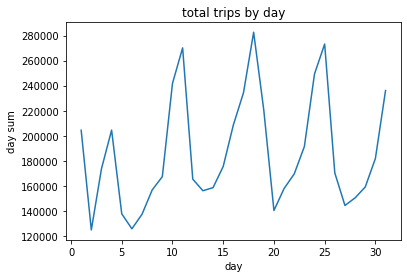

In [79]:
plt.plot(day_agg)
plt.xlabel('day')
plt.ylabel('day sum')
plt.title('total trips by day')
plt.show()

In [62]:
### look at OD pair 1
OD = TNC_2020_Jan_Tiger_GB_df[(TNC_2020_Jan_Tiger_GB_df['Pickup Census Tract']==17031010400)&(TNC_2020_Jan_Tiger_GB_df['Dropoff Census Tract']==17031010400)]
len(OD) # meaning 24 out of 31 days have record

24

In [65]:
# create a multiindex for df
Day = np.arange(1,32).tolist() # 1-31
#Hour = np.arange(24).tolist() # 0 -23
arrays = [CT_list.tolist(),CT_list.tolist(),Day]

#tuples = list(zip(*arrays))
indexes = pd.MultiIndex.from_product(arrays,names = ['Pickup Census Tract','Dropoff Census Tract','Day'])
indexes

MultiIndex([(17031010400, 17031010400,  1),
            (17031010400, 17031010400,  2),
            (17031010400, 17031010400,  3),
            (17031010400, 17031010400,  4),
            (17031010400, 17031010400,  5),
            (17031010400, 17031010400,  6),
            (17031010400, 17031010400,  7),
            (17031010400, 17031010400,  8),
            (17031010400, 17031010400,  9),
            (17031010400, 17031010400, 10),
            ...
            (17031030102, 17031030102, 22),
            (17031030102, 17031030102, 23),
            (17031030102, 17031030102, 24),
            (17031030102, 17031030102, 25),
            (17031030102, 17031030102, 26),
            (17031030102, 17031030102, 27),
            (17031030102, 17031030102, 28),
            (17031030102, 17031030102, 29),
            (17031030102, 17031030102, 30),
            (17031030102, 17031030102, 31)],
           names=['Pickup Census Tract', 'Dropoff Census Tract', 'Day'], length=19889631)

In [67]:
TNC_2020_Jan_Tiger_GB.head()

exist_O
Pickup Census Tract Dropoff Census Tract TripStartDay         
1.703101e+10        1.703101e+10         3                 1.0
                                         4                 2.0
                                         7                 4.0
                                         9                 1.0
                                         10                3.0

In [68]:
TNC_2020_Jan_Tiger_GB_fill = TNC_2020_Jan_Tiger_GB.reindex(indexes)

In [71]:
TNC_2020_Jan_Tiger_GB_fill_zero = TNC_2020_Jan_Tiger_GB_fill.fillna(0).astype(int)
TNC_2020_Jan_Tiger_GB_fill_zero.head()

exist_O
Pickup Census Tract Dropoff Census Tract Day         
17031010400         17031010400          1          2
                                         2          0
                                         3          0
                                         4          0
                                         5          0

In [72]:
# those two values should match
len(TNC_2020_Jan_Tiger_GB_fill_zero),801*801*31

(19889631, 19889631)

In [81]:
TNC_2020_Jan_Tiger_GB_fill_zero.to_csv('OD/ODTime_2020_Jan.csv')

In [82]:
TNC_2020_Jan_Tiger_GB_fill_zero_unstack = TNC_2020_Jan_Tiger_GB_fill_zero.unstack(level=-1)
TNC_2020_Jan_Tiger_GB_fill_zero_unstack.head()

exist_O                             \
Day                                           1  2  3  4  5  6  7  8  9  10   
Pickup Census Tract Dropoff Census Tract                                      
17031010100         17031010100                0  0  1  2  0  0  4  0  1  3   
                    17031010201                3  1  0  0  1  0  2  2  1  4   
                    17031010202                0  1  1  1  2  1  2  2  0  2   
                    17031010300                1  2  3  1  0  2  2  3  0  0   
                    17031010400                1  0  1  0  1  0  0  0  0  1   

                                          ...                                
Day                                       ... 22 23 24 25 26 27 28 29 30 31  
Pickup Census Tract Dropoff Census Tract  ...                                
17031010100         17031010100           ...  0  1  2  3  0  1  0  4  2  1  
                    17031010201           ...  4  0  3  3  2  4  1  0  1  4  
                    17031010202           ...  0  2  2  0  1  2  1  1  2  2  
                    17031010300           ...  2  1  3  4  2  1  0  1  1  3  
                    17031010400           ...  2  2  1  2  1  0  3  3  3  0  

[5 rows x 31 columns]

In [85]:
TNC_2020_Jan_OD = TNC_2020_Jan_Tiger_GB_fill_zero_unstack.values
TNC_2020_Jan_OD

array([[ 0,  0,  1, ...,  4,  2,  1],
       [ 3,  1,  0, ...,  0,  1,  4],
       [ 0,  1,  1, ...,  1,  2,  2],
       ...,
       [ 1,  2,  0, ...,  0,  0,  0],
       [23, 10, 16, ...,  9, 18, 13],
       [ 4,  1,  4, ...,  4,  8,  4]])

In [78]:
Day1 = TNC_2020_Jan_Tiger_GB_fill_zero.iloc[TNC_2020_Jan_Tiger_GB_fill_zero.index.get_level_values('Day')==1]
Day1.sum()

exist_O    204369
dtype: int64

TNC_2020_Jan_OD.shape

In [91]:
np.max(TNC_2020_Jan_OD)

1076

In [87]:
np.savetxt('OD/TNC_2020_Jan_OD.csv',TNC_2020_Jan_OD,delimiter = ",")

In [109]:
TNC_2020_Jan_OD

array([[ 0,  0,  1, ...,  4,  2,  1],
       [ 3,  1,  0, ...,  0,  1,  4],
       [ 0,  1,  1, ...,  1,  2,  2],
       ...,
       [ 1,  2,  0, ...,  0,  0,  0],
       [23, 10, 16, ...,  9, 18, 13],
       [ 4,  1,  4, ...,  4,  8,  4]])

In [110]:
stats.describe(TNC_2020_Jan_OD)

DescribeResult(nobs=641601, minmax=(array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0]), array([ 321,  346,  415,  324,  360,  645,  446,  605,  768,  699,  464,
        696, 1022,  558,  672, 1076,  889,  464,  468,  636,  700,  734,
        928,  801,  464,  394,  828,  616,  702,  959,  828])), mean=array([0.31852974, 0.1944573 , 0.27051859, 0.31871521, 0.21453053,
       0.19582575, 0.21400216, 0.24419382, 0.26076487, 0.37687285,
       0.42106543, 0.25767104, 0.24323372, 0.24711464, 0.27344876,
       0.32511951, 0.3652566 , 0.44055573, 0.34357178, 0.21860159,
       0.24594725, 0.26416885, 0.29824611, 0.38870731, 0.42584878,
       0.26536274, 0.22489522, 0.23436372, 0.24789082, 0.28334744,
       0.36794675]), variance=array([ 9.68141427,  7.26217383, 10.69222326, 10.60735749,  5.63612901,
        9.35471019, 10.19452719, 15.52083531, 16.17924753, 21.7955508 ,
       19.59148168, 10.28269219, 18.79250341, 17.87224629, 21.40

In [113]:
stat_row = stats.describe(TNC_2020_Jan_OD.T)
stat_row

DescribeResult(nobs=31, minmax=(array([0, 0, 0, ..., 0, 9, 1]), array([  4,   6,   5, ...,   3, 186,   9])), mean=array([ 1.32258065,  1.80645161,  1.48387097, ...,  1.03225806,
       21.87096774,  4.5483871 ]), variance=array([1.55913978e+00, 2.69462366e+00, 1.39139785e+00, ...,
       8.32258065e-01, 9.74716129e+02, 4.25591398e+00]), skewness=array([0.83011021, 0.63706519, 0.96816103, ..., 0.74006162, 4.92001202,
       0.27724386]), kurtosis=array([-0.18143639, -0.51345597,  1.16143107, ..., -0.08073433,
       23.32766403, -0.31059309]))

In [120]:
# OD pair: total, non-zero, zero
max_list = stat_row[1][1]
len(max_list) , np.count_nonzero(max_list),len(max_list)-np.count_nonzero(max_list)

(641601, 215327, 426274)

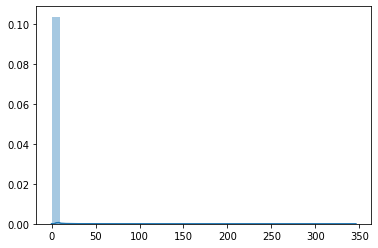

In [106]:
sns.distplot(TNC_2020_Jan_OD[:,1],hist = True,kde = True,bins = int(180/5))

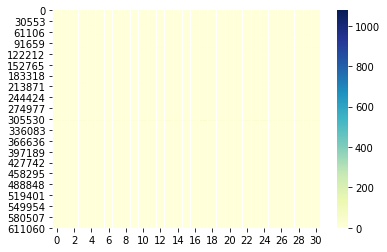

In [93]:
sns.heatmap(TNC_2020_Jan_OD,cmap = 'YlGnBu')

## OD matrix finished
## ------------------

# --------------------------
## look at 2020 in general
# --------------------------

In [65]:
TNC_Year2020.shape

(23184407, 31)

In [66]:
TNC_Year2020_Com = TNC_Year2020[TNC_Year2020[['Pickup Community Area', 'Dropoff Community Area']].notnull().all(1)]

In [67]:
#turns out are  CA used
len(TNC_Year2020_Com['Pickup Community Area'].unique())

77

In [68]:
TNC_Year2020_Com.shape

(19973540, 31)

In [69]:
#those trips with missing O CA or D CA(or both),and percentage
(TNC_Year2020.shape[0] - TNC_Year2020_Com.shape[0]),(TNC_Year2020.shape[0] - TNC_Year2020_Com.shape[0])/TNC_Year2020.shape[0]


(3210867, 0.13849252215077143)

In [ ]:
## select trips with both record of O and D census tract (remove na for both columns)

In [70]:
TNC_Year2020_Tract = TNC_Year2020[TNC_Year2020[['Pickup Census Tract', 'Dropoff Census Tract']].notnull().all(1)]

In [71]:
TNC_Year2020_Tract.head()

,Trip ID,Trip Start Timestamp,Trip End Timestamp,Trip Seconds,Trip Miles,Pickup Census Tract,Dropoff Census Tract,Pickup Community Area,Dropoff Community Area,Fare,...,TripStartMonth,TripStartDay,TripStartYear,TripStartHour,TripStartMin,TripEndMonth,TripEndDay,TripEndYear,TripEndHour,TripEndMin
5,8d881e1cf186acd9ca36dadab9413f6bbf1ba55d,2020-02-12 09:15:00,2020-02-12 09:30:00,1537.0,16.5,1.703146e+10,1.703184e+10,46.0,30.0,20.0,...,2,12,2020,9,15,2,12,2020,9,30
13,8d88b87afb5ef17a8c011337ac8396d174b9a7fe,2020-03-01 21:15:00,2020-03-01 21:15:00,374.0,2.3,1.703171e+10,1.703168e+10,71.0,68.0,7.5,...,3,1,2020,21,15,3,1,2020,21,15
16,8d895c666733e9c7b545331b15c8b6346fc8987f,2020-03-07 01:15:00,2020-03-07 01:30:00,988.0,6.7,1.703108e+10,1.703107e+10,8.0,7.0,10.0,...,3,7,2020,1,15,3,7,2020,1,30
21,8d8a208f77ba8828f159b7c840b63526c92b0e88,2020-02-15 17:15:00,2020-02-15 17:30:00,277.0,1.0,1.703107e+10,1.703183e+10,7.0,7.0,5.0,...,2,15,2020,17,15,2,15,2020,17,30
27,8d8a9f1d0b577d9aaaa9a55294fdbfc71ab6791a,2020-02-04 17:45:00,2020-02-04 18:00:00,302.0,0.7,1.703108e+10,1.703108e+10,8.0,8.0,5.0,...,2,4,2020,17,45,2,4,2020,18,0


In [72]:
TNC_Year2020_Tract.shape

(14883520, 31)

In [73]:
# how many census tracts are used - turns out 1041 CT are used
len(TNC_Year2020_Tract['Pickup Census Tract'].unique())

1041

In [74]:
#those trips with missing O CT or D CT(or both),and percentage
(TNC_Year2020.shape[0] - TNC_Year2020_Tract.shape[0]),(TNC_Year2020.shape[0] - TNC_Year2020_Tract.shape[0])/TNC_Year2020.shape[0]

(8300887, 0.35803749476965274)

In [75]:
TNC_Year2020_Tract_2 = TNC_Year2020_Tract.dropna(subset=['Pickup Census Tract', 'Dropoff Census Tract'], thresh = 2)


In [76]:
TNC_Year2020_Tract_2.head()

,Trip ID,Trip Start Timestamp,Trip End Timestamp,Trip Seconds,Trip Miles,Pickup Census Tract,Dropoff Census Tract,Pickup Community Area,Dropoff Community Area,Fare,...,TripStartMonth,TripStartDay,TripStartYear,TripStartHour,TripStartMin,TripEndMonth,TripEndDay,TripEndYear,TripEndHour,TripEndMin
5,8d881e1cf186acd9ca36dadab9413f6bbf1ba55d,2020-02-12 09:15:00,2020-02-12 09:30:00,1537.0,16.5,1.703146e+10,1.703184e+10,46.0,30.0,20.0,...,2,12,2020,9,15,2,12,2020,9,30
13,8d88b87afb5ef17a8c011337ac8396d174b9a7fe,2020-03-01 21:15:00,2020-03-01 21:15:00,374.0,2.3,1.703171e+10,1.703168e+10,71.0,68.0,7.5,...,3,1,2020,21,15,3,1,2020,21,15
16,8d895c666733e9c7b545331b15c8b6346fc8987f,2020-03-07 01:15:00,2020-03-07 01:30:00,988.0,6.7,1.703108e+10,1.703107e+10,8.0,7.0,10.0,...,3,7,2020,1,15,3,7,2020,1,30
21,8d8a208f77ba8828f159b7c840b63526c92b0e88,2020-02-15 17:15:00,2020-02-15 17:30:00,277.0,1.0,1.703107e+10,1.703183e+10,7.0,7.0,5.0,...,2,15,2020,17,15,2,15,2020,17,30
27,8d8a9f1d0b577d9aaaa9a55294fdbfc71ab6791a,2020-02-04 17:45:00,2020-02-04 18:00:00,302.0,0.7,1.703108e+10,1.703108e+10,8.0,8.0,5.0,...,2,4,2020,17,45,2,4,2020,18,0


In [77]:
TNC_Year2020_Tract_2.shape

(14883520, 31)

# ----------------------------------------
# choropleth plot for different Os
# ----------------------------------------

In [3]:
# load json file for GIS plot
with open('Boundaries - Census Tracts - 2010.geojson') as response:
     CensusTract = json.load(response)

In [19]:
Block = pd.read_csv('CensusBlockTIGER2010.csv')
Tract = pd.read_csv('CensusTractsTIGER2010.csv')
pop_Block = pd.read_csv('Population_by_2010_Census_Block.csv')

In [20]:
Block.head()

,the_geom,STATEFP10,COUNTYFP10,TRACTCE10,BLOCKCE10,GEOID10,NAME10,TRACT_BLOC
0,MULTIPOLYGON (((-87.6290679994106 41.769086000...,17,31,690300,2010,170316903002010,Block 2010,6903002010
1,MULTIPOLYGON (((-87.6341179992764 41.774465999...,17,31,680900,3007,170316809003007,Block 3007,6809003007
2,MULTIPOLYGON (((-87.63485400018324 41.77263300...,17,31,680900,3013,170316809003013,Block 3013,6809003013
3,MULTIPOLYGON (((-87.73841099998789 41.85913100...,17,31,290900,4019,170312909004019,Block 4019,2909004019
4,MULTIPOLYGON (((-87.73217300001724 41.85476400...,17,31,292500,4016,170312925004016,Block 4016,2925004016


In [21]:
Tract.head()

,the_geom,STATEFP10,COUNTYFP10,TRACTCE10,GEOID10,NAME10,NAMELSAD10,COMMAREA,COMMAREA_N,NOTES
0,MULTIPOLYGON (((-87.62404799998049 41.73021699...,17,31,842400,17031842400,8424.0,Census Tract 8424,44,44,NaN
1,MULTIPOLYGON (((-87.6860799999848 41.822956000...,17,31,840300,17031840300,8403.0,Census Tract 8403,59,59,NaN
2,MULTIPOLYGON (((-87.62934700001182 41.85279700...,17,31,841100,17031841100,8411.0,Census Tract 8411,34,34,NaN
3,MULTIPOLYGON (((-87.68813499997718 41.85569099...,17,31,841200,17031841200,8412.0,Census Tract 8412,31,31,NaN
4,MULTIPOLYGON (((-87.63312200003458 41.87448800...,17,31,839000,17031839000,8390.0,Census Tract 8390,32,32,NaN


In [22]:
pop_Block.head()

,CENSUS BLOCK,CENSUS BLOCK FULL,TOTAL POPULATION
0,310003002,170310310003002,104
1,310003003,170310310003003,46
2,310003004,170310310003004,40
3,310003005,170310310003005,58
4,310003006,170310310003006,75


In [30]:
pop_Block.shape,Block.shape,Tract.shape

((46291, 3), (46357, 8), (801, 10))

In [31]:
Block_join = pd.merge(left=Block, right=pop_Block, left_on='GEOID10', right_on='CENSUS BLOCK FULL')
Block_join.shape

(46337, 11)

In [32]:
Block_join.head()

,the_geom,STATEFP10,COUNTYFP10,TRACTCE10,BLOCKCE10,GEOID10,NAME10,TRACT_BLOC,CENSUS BLOCK,CENSUS BLOCK FULL,TOTAL POPULATION
0,MULTIPOLYGON (((-87.6290679994106 41.769086000...,17,31,690300,2010,170316903002010,Block 2010,6903002010,6903002010,170316903002010,62
1,MULTIPOLYGON (((-87.6341179992764 41.774465999...,17,31,680900,3007,170316809003007,Block 3007,6809003007,6809003007,170316809003007,15
2,MULTIPOLYGON (((-87.63485400018324 41.77263300...,17,31,680900,3013,170316809003013,Block 3013,6809003013,6809003013,170316809003013,104
3,MULTIPOLYGON (((-87.73841099998789 41.85913100...,17,31,290900,4019,170312909004019,Block 4019,2909004019,2909004019,170312909004019,3
4,MULTIPOLYGON (((-87.73217300001724 41.85476400...,17,31,292500,4016,170312925004016,Block 4016,2925004016,2925004016,170312925004016,84


In [48]:
pop_Tract = Block_join.groupby(['TRACTCE10'],as_index = False).sum()
pop_Tract.shape

(807, 9)

In [49]:
pop_Tract.head()


,TRACTCE10,STATEFP10,COUNTYFP10,BLOCKCE10,GEOID10,TRACT_BLOC,CENSUS BLOCK,CENSUS BLOCK FULL,TOTAL POPULATION
0,10100,561,1023,77178,5620233333077178,3333077178,3333077178,5620233333077178,4854
1,10201,1139,2077,132977,11410776834802976,6834802977,6834802977,11410776834802976,6450
2,10202,425,775,36146,4257752550536146,2550536146,2550536146,4257752550536146,2818
3,10300,833,1519,128314,8345195047128314,5047128314,5047128314,8345195047128314,6236
4,10400,510,930,68169,5109303120068169,3120068169,3120068169,5109303120068169,5042


In [50]:
pop_Tract.columns

Index(['TRACTCE10', 'STATEFP10', 'COUNTYFP10', 'BLOCKCE10', 'GEOID10',
       'TRACT_BLOC', 'CENSUS BLOCK', 'CENSUS BLOCK FULL', 'TOTAL POPULATION'],
      dtype='object')

In [59]:
pop_Tract.columns = ['tractce10', 'STATEFP10', 'COUNTYFP10', 'BLOCKCE10', 'geoid10',
       'TRACT_BLOC', 'CENSUS BLOCK', 'CENSUS BLOCK FULL', 'TOTAL POPULATION']
pop_Tract.columns

Index(['tractce10', 'STATEFP10', 'COUNTYFP10', 'BLOCKCE10', 'geoid10',
       'TRACT_BLOC', 'CENSUS BLOCK', 'CENSUS BLOCK FULL', 'TOTAL POPULATION'],
      dtype='object')

In [69]:
pop_Tract.head()

,tractce10,STATEFP10,COUNTYFP10,BLOCKCE10,geoid10,TRACT_BLOC,CENSUS BLOCK,CENSUS BLOCK FULL,TOTAL POPULATION
0,10100,561,1023,77178,5620233333077178,3333077178,3333077178,5620233333077178,4854
1,10201,1139,2077,132977,11410776834802976,6834802977,6834802977,11410776834802976,6450
2,10202,425,775,36146,4257752550536146,2550536146,2550536146,4257752550536146,2818
3,10300,833,1519,128314,8345195047128314,5047128314,5047128314,8345195047128314,6236
4,10400,510,930,68169,5109303120068169,3120068169,3120068169,5109303120068169,5042


In [74]:
pop_Tract[pop_Tract['COUNTYFP10']=='031'].head()

,tractce10,STATEFP10,COUNTYFP10,BLOCKCE10,geoid10,TRACT_BLOC,CENSUS BLOCK,CENSUS BLOCK FULL,TOTAL POPULATION


In [73]:
CensusTract["features"][1]

{'type': 'Feature',
 'properties': {'statefp10': '17',
  'name10': '8403',
  'commarea_n': '59',
  'namelsad10': 'Census Tract 8403',
  'commarea': '59',
  'geoid10': '17031840300',
  'notes': '',
  'tractce10': '840300',
  'countyfp10': '031'},
 'geometry': {'type': 'MultiPolygon',
  'coordinates': [[[[-87.6860799999848, 41.82295600001154],
     [-87.68606600004208, 41.82301899996352],
     [-87.68607699997101, 41.82330899998973],
     [-87.68608000004309, 41.823383999978184],
     [-87.6861219999606, 41.82416099998552],
     [-87.68612000002825, 41.82419500000042],
     [-87.68612999996847, 41.824313999993066],
     [-87.68614400001749, 41.824351999992395],
     [-87.68619700002532, 41.82441900000564],
     [-87.68628300001852, 41.82450500000979],
     [-87.68636200004383, 41.824583000003834],
     [-87.68666800001778, 41.824886000026126],
     [-87.68663399997084, 41.824906000004155],
     [-87.68653499995962, 41.82496900000112],
     [-87.68650200000407, 41.82499000002694],
     [-

# cencus tract for Chicago

In [91]:


#generate a choropleth plot file

fig = px.choropleth_mapbox(Tract, geojson=CensusTract, locations = 'GEOID10', color='STATEFP10',
                           color_continuous_scale="Viridis",
                            #color_continuous_scale='Inferno',
                           range_color=(0, 100),
                           mapbox_style="carto-positron",
                           featureidkey = 'properties.geoid10',
                           zoom=9, center = {"lat": 41.8341, "lon": -87.7321},
                           opacity=0.5
                           #labels={'POP':'POP'}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0},coloraxis_showscale=False)
fig.show()



In [75]:
def cho_mapbox_file(O_flow,i,community):
    
    # generate a choropleth plot file
    demand_max = np.max(O_flow['Demand'])
    fig = px.choropleth_mapbox(O_flow, geojson=community, locations='D', color='Demand',
                               color_continuous_scale="Viridis",
                                #color_continuous_scale='Inferno',
                               range_color=(0, demand_max),
                               mapbox_style="carto-positron",
                               featureidkey = 'properties.area_num_1',
                               zoom=9, center = {"lat": 41.8341, "lon": -87.7321},
                               opacity=0.5,
                               labels={'Demand':'Distribution of O Flow'}
                              )
    fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
    
    filename = "TNC_TRIP_Analysis/OD_choropleth/Total_O" + str(i) + ".pdf"
    fig.write_image(filename)
    #fig.show()

# now we generate OD for all O_is 

In [19]:
# for i in np.arange(1,N+1):
#     Oi = get_Oi(OD_df,i)
#     cho_mapbox_file(Oi,i,community)

In [20]:
Oi = get_Oi(OD_df,1)
cho_mapbox(Oi,community)

In [21]:
Oi = get_Oi(OD_df,8)
cho_mapbox(Oi,community)

In [22]:
Oi = get_Oi(OD_df,28)
cho_mapbox(Oi,community)

In [23]:
np.savetxt("TNC_TRIP_Analysis/Total_OD.csv", OD, delimiter=",")

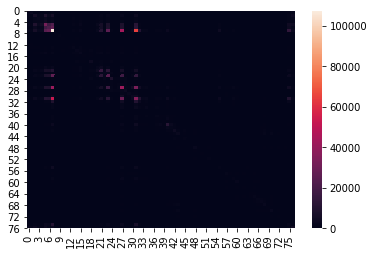

In [24]:
sns.heatmap(OD)

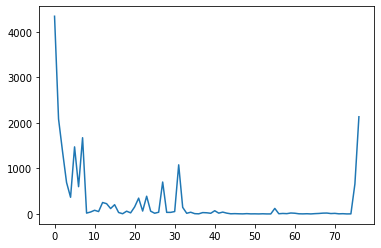

In [25]:
plt.plot(OD[0,:]) # O = 1

# Graph matrices
# L - Graph Laplacian
# D - Degree matrix
# W - Weight matrix
# Graph Laplacian and signals as O flow

# for this case we assume those community areas is connected by a complete graph - undirected , weight = 1

In [26]:
def check_symmetric(a, tol=1e-8):
    return np.all(np.abs(a-a.T) < tol)

In [27]:
N = 77

In [28]:
D = np.eye(N)*(N-1)
D

array([[76.,  0.,  0., ...,  0.,  0.,  0.],
       [ 0., 76.,  0., ...,  0.,  0.,  0.],
       [ 0.,  0., 76., ...,  0.,  0.,  0.],
       ...,
       [ 0.,  0.,  0., ..., 76.,  0.,  0.],
       [ 0.,  0.,  0., ...,  0., 76.,  0.],
       [ 0.,  0.,  0., ...,  0.,  0., 76.]])

In [29]:
W = np.ones((N))-np.eye(N)
W

array([[0., 1., 1., ..., 1., 1., 1.],
       [1., 0., 1., ..., 1., 1., 1.],
       [1., 1., 0., ..., 1., 1., 1.],
       ...,
       [1., 1., 1., ..., 0., 1., 1.],
       [1., 1., 1., ..., 1., 0., 1.],
       [1., 1., 1., ..., 1., 1., 0.]])

In [30]:
L = D - W
L

array([[76., -1., -1., ..., -1., -1., -1.],
       [-1., 76., -1., ..., -1., -1., -1.],
       [-1., -1., 76., ..., -1., -1., -1.],
       ...,
       [-1., -1., -1., ..., 76., -1., -1.],
       [-1., -1., -1., ..., -1., 76., -1.],
       [-1., -1., -1., ..., -1., -1., 76.]])

In [31]:
P = np.dot(LA.inv(D),W)
P

array([[0.        , 0.01315789, 0.01315789, ..., 0.01315789, 0.01315789,
        0.01315789],
       [0.01315789, 0.        , 0.01315789, ..., 0.01315789, 0.01315789,
        0.01315789],
       [0.01315789, 0.01315789, 0.        , ..., 0.01315789, 0.01315789,
        0.01315789],
       ...,
       [0.01315789, 0.01315789, 0.01315789, ..., 0.        , 0.01315789,
        0.01315789],
       [0.01315789, 0.01315789, 0.01315789, ..., 0.01315789, 0.        ,
        0.01315789],
       [0.01315789, 0.01315789, 0.01315789, ..., 0.01315789, 0.01315789,
        0.        ]])

In [32]:
check_symmetric(P)

True

In [33]:
LA.eigh(P)

(array([-0.01315789, -0.01315789, -0.01315789, -0.01315789, -0.01315789,
        -0.01315789, -0.01315789, -0.01315789, -0.01315789, -0.01315789,
        -0.01315789, -0.01315789, -0.01315789, -0.01315789, -0.01315789,
        -0.01315789, -0.01315789, -0.01315789, -0.01315789, -0.01315789,
        -0.01315789, -0.01315789, -0.01315789, -0.01315789, -0.01315789,
        -0.01315789, -0.01315789, -0.01315789, -0.01315789, -0.01315789,
        -0.01315789, -0.01315789, -0.01315789, -0.01315789, -0.01315789,
        -0.01315789, -0.01315789, -0.01315789, -0.01315789, -0.01315789,
        -0.01315789, -0.01315789, -0.01315789, -0.01315789, -0.01315789,
        -0.01315789, -0.01315789, -0.01315789, -0.01315789, -0.01315789,
        -0.01315789, -0.01315789, -0.01315789, -0.01315789, -0.01315789,
        -0.01315789, -0.01315789, -0.01315789, -0.01315789, -0.01315789,
        -0.01315789, -0.01315789, -0.01315789, -0.01315789, -0.01315789,
        -0.01315789, -0.01315789, -0.01315789, -0.0

In [34]:
LA.eig(P)

(array([-0.01315789+0.00000000e+00j,  1.        +0.00000000e+00j,
        -0.01315789+0.00000000e+00j, -0.01315789+0.00000000e+00j,
        -0.01315789+0.00000000e+00j, -0.01315789+0.00000000e+00j,
        -0.01315789+0.00000000e+00j, -0.01315789+1.56125113e-17j,
        -0.01315789-1.56125113e-17j, -0.01315789+0.00000000e+00j,
        -0.01315789+6.00925839e-18j, -0.01315789-6.00925839e-18j,
        -0.01315789+1.32853482e-17j, -0.01315789-1.32853482e-17j,
        -0.01315789+0.00000000e+00j, -0.01315789+0.00000000e+00j,
        -0.01315789+0.00000000e+00j, -0.01315789+3.87895961e-18j,
        -0.01315789-3.87895961e-18j, -0.01315789+1.93996462e-17j,
        -0.01315789-1.93996462e-17j, -0.01315789+0.00000000e+00j,
        -0.01315789+0.00000000e+00j, -0.01315789+0.00000000e+00j,
        -0.01315789+0.00000000e+00j, -0.01315789+0.00000000e+00j,
        -0.01315789+0.00000000e+00j, -0.01315789+0.00000000e+00j,
        -0.01315789+1.14057862e-17j, -0.01315789-1.14057862e-17j,
        -0

In [35]:
LA.matrix_rank(L) # check the rank of the laplacian

76

In [36]:
values, vectors = LA.eig(L)

In [37]:
values

array([-8.82392179e-15+0.00000000e+00j,  7.70000000e+01+0.00000000e+00j,
        7.70000000e+01+0.00000000e+00j,  7.70000000e+01+0.00000000e+00j,
        7.70000000e+01+0.00000000e+00j,  7.70000000e+01+0.00000000e+00j,
        7.70000000e+01+0.00000000e+00j,  7.70000000e+01+0.00000000e+00j,
        7.70000000e+01+0.00000000e+00j,  7.70000000e+01+4.26325641e-14j,
        7.70000000e+01-4.26325641e-14j,  7.70000000e+01+0.00000000e+00j,
        7.70000000e+01+0.00000000e+00j,  7.70000000e+01+0.00000000e+00j,
        7.70000000e+01+0.00000000e+00j,  7.70000000e+01+0.00000000e+00j,
        7.70000000e+01+0.00000000e+00j,  7.70000000e+01+0.00000000e+00j,
        7.70000000e+01+0.00000000e+00j,  7.70000000e+01+0.00000000e+00j,
        7.70000000e+01+0.00000000e+00j,  7.70000000e+01+0.00000000e+00j,
        7.70000000e+01+0.00000000e+00j,  7.70000000e+01+0.00000000e+00j,
        7.70000000e+01+0.00000000e+00j,  7.70000000e+01+0.00000000e+00j,
        7.70000000e+01+0.00000000e+00j,  7.70000000

In [38]:
vectors

array([[-1.13960576e-01+0.j,  5.97764932e-15+0.j,  9.79310501e-01+0.j,
        ..., -9.64346960e-02+0.j,  1.83671252e-02+0.j,
         1.60939198e-02+0.j],
       [-1.13960576e-01+0.j, -9.88718063e-01+0.j,  9.03845881e-02+0.j,
        ..., -2.31003141e-02+0.j,  6.32651860e-03+0.j,
         1.45190555e-02+0.j],
       [-1.13960576e-01+0.j, -7.60057540e-02+0.j, -1.33270444e-01+0.j,
        ..., -1.67625828e-01+0.j, -7.12864432e-02+0.j,
        -1.25956240e-02+0.j],
       ...,
       [-1.13960576e-01+0.j,  1.38473855e-02+0.j, -1.50967467e-02+0.j,
        ..., -1.36903249e-01+0.j,  1.94300407e-03+0.j,
         2.25277083e-02+0.j],
       [-1.13960576e-01+0.j,  1.32367255e-02+0.j, -1.38052614e-02+0.j,
        ...,  4.46668990e-02+0.j,  3.08966589e-03+0.j,
         8.48660975e-03+0.j],
       [-1.13960576e-01+0.j,  1.12209242e-02+0.j, -1.40277280e-02+0.j,
        ..., -8.07510433e-02+0.j, -1.84183431e-02+0.j,
        -1.69599987e-02+0.j]])

In [68]:
L

array([[76., -1., -1., ..., -1., -1., -1.],
       [-1., 76., -1., ..., -1., -1., -1.],
       [-1., -1., 76., ..., -1., -1., -1.],
       ...,
       [-1., -1., -1., ..., 76., -1., -1.],
       [-1., -1., -1., ..., -1., 76., -1.],
       [-1., -1., -1., ..., -1., -1., 76.]])

In [69]:
values, vectors = LA.eigh(L)
values

array([-1.42108547e-14,  7.70000000e+01,  7.70000000e+01,  7.70000000e+01,
        7.70000000e+01,  7.70000000e+01,  7.70000000e+01,  7.70000000e+01,
        7.70000000e+01,  7.70000000e+01,  7.70000000e+01,  7.70000000e+01,
        7.70000000e+01,  7.70000000e+01,  7.70000000e+01,  7.70000000e+01,
        7.70000000e+01,  7.70000000e+01,  7.70000000e+01,  7.70000000e+01,
        7.70000000e+01,  7.70000000e+01,  7.70000000e+01,  7.70000000e+01,
        7.70000000e+01,  7.70000000e+01,  7.70000000e+01,  7.70000000e+01,
        7.70000000e+01,  7.70000000e+01,  7.70000000e+01,  7.70000000e+01,
        7.70000000e+01,  7.70000000e+01,  7.70000000e+01,  7.70000000e+01,
        7.70000000e+01,  7.70000000e+01,  7.70000000e+01,  7.70000000e+01,
        7.70000000e+01,  7.70000000e+01,  7.70000000e+01,  7.70000000e+01,
        7.70000000e+01,  7.70000000e+01,  7.70000000e+01,  7.70000000e+01,
        7.70000000e+01,  7.70000000e+01,  7.70000000e+01,  7.70000000e+01,
        7.70000000e+01,  

In [40]:
vectors

array([[ 0.11396058,  0.        ,  0.        , ...,  0.        ,
         0.        ,  0.        ],
       [ 0.11396058,  0.00241625,  0.01448654, ..., -0.02785917,
         0.2061786 , -0.00695488],
       [ 0.11396058, -0.00180861,  0.03277821, ..., -0.01322351,
         0.18631122, -0.00382512],
       ...,
       [ 0.11396058, -0.00845182, -0.01395991, ...,  0.08352937,
         0.15277306, -0.01701932],
       [ 0.11396058, -0.06382726,  0.05713338, ...,  0.03029571,
        -0.00177109,  0.00812845],
       [ 0.11396058, -0.00356167,  0.09151793, ...,  0.05443839,
         0.15277306,  0.0141842 ]])

In [41]:
(np.imag(vectors) == 0).any()

True

In [42]:
eigenvec = np.real(vectors)
eigenvec

array([[ 0.11396058,  0.        ,  0.        , ...,  0.        ,
         0.        ,  0.        ],
       [ 0.11396058,  0.00241625,  0.01448654, ..., -0.02785917,
         0.2061786 , -0.00695488],
       [ 0.11396058, -0.00180861,  0.03277821, ..., -0.01322351,
         0.18631122, -0.00382512],
       ...,
       [ 0.11396058, -0.00845182, -0.01395991, ...,  0.08352937,
         0.15277306, -0.01701932],
       [ 0.11396058, -0.06382726,  0.05713338, ...,  0.03029571,
        -0.00177109,  0.00812845],
       [ 0.11396058, -0.00356167,  0.09151793, ...,  0.05443839,
         0.15277306,  0.0141842 ]])

In [43]:
eigenvec_inv = LA.inv(eigenvec)
eigenvec_inv

array([[ 1.13960576e-01,  1.13960576e-01,  1.13960576e-01, ...,
         1.13960576e-01,  1.13960576e-01,  1.13960576e-01],
       [ 3.08817797e-17,  2.41624879e-03, -1.80860836e-03, ...,
        -8.45181979e-03, -6.38272608e-02, -3.56166659e-03],
       [ 1.38068779e-18,  1.44865443e-02,  3.27782084e-02, ...,
        -1.39599078e-02,  5.71333836e-02,  9.15179320e-02],
       ...,
       [-1.09769832e-17, -2.78591706e-02, -1.32235147e-02, ...,
         8.35293696e-02,  3.02957145e-02,  5.44383920e-02],
       [-2.80825391e-19,  2.06178604e-01,  1.86311218e-01, ...,
         1.52773058e-01, -1.77109369e-03,  1.52773058e-01],
       [-1.69760050e-18, -6.95488257e-03, -3.82511823e-03, ...,
        -1.70193186e-02,  8.12844774e-03,  1.41842012e-02]])

In [44]:
Oi = get_Oi(OD_df,1)
O_1 = Oi
O_1_hat = np.dot(eigenvec_inv,O_1['Demand'])
O_1_hat

array([ 2299.4965118 ,   -82.13148819,   418.27378176,   553.79217378,
        -164.92253142,   -52.11964583,   403.24950863,   371.94212424,
        -141.66393113,  -759.22684822,   374.70389187,  -568.07328392,
         131.7073851 ,   264.92947226,   -89.56566702,   -74.65610267,
        -376.71965858,   -10.0013064 ,   392.76992121,   377.69435048,
         221.72879476,   234.28114167,   305.52300895,    36.22702707,
        -538.71555739, -1643.46818169,   222.14889567,   115.28257312,
         402.72234771,  -242.42307455,  -155.69002671,   194.59992455,
         785.4975353 ,    16.08505896,   129.86801327,   223.68321667,
         -91.8849303 ,  4424.81984203,  -115.89063102,  -273.85078972,
         381.38556562,   445.46870745,  -309.44638768,    80.63040094,
        -341.44220997,  -509.10381534,  -968.00746286,   -73.93127167,
         -42.30896715,   172.40440727,  -151.06786619,  -872.91748235,
         -28.27646305,    80.65880203,     7.85863504,   175.70367164,
      

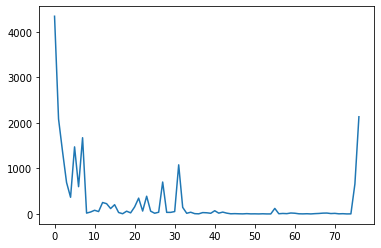

In [45]:
plt.plot(O_1['Demand'])

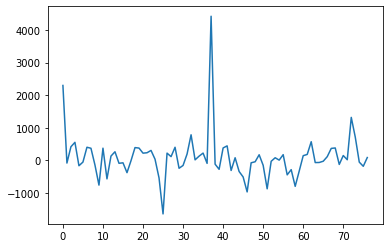

In [46]:
plt.plot(O_1_hat) # graph fourier transform

In [47]:
O_1

,O,D,Demand
0,1.0,1.0,4346.0
1,1.0,2.0,2087.0
2,1.0,3.0,1370.0
3,1.0,4.0,691.0
4,1.0,5.0,366.0
...,...,...,...
72,1.0,73.0,5.0
73,1.0,74.0,0.0
74,1.0,75.0,1.0
75,1.0,76.0,658.0


In [71]:
i = 2
Oi = get_Oi(OD_df,i)
S2_O = np.dot(np.dot(OD[i,:],L),OD[i,:].T)
S2_O


13446563548.0

In [49]:
energy = LA.norm(OD[i,:])**2
energy

38262161.99999999

In [50]:
S2_O/energy

66.35889498350879

# now we seperate day of week and time of day

In [51]:
data = triptable_time.copy()

In [52]:
data.shape

(2421235, 21)

In [53]:
data.head()

,Trip ID,Trip Start Timestamp,Trip End Timestamp,Trip Seconds,Trip Miles,Pickup Census Tract,Dropoff Census Tract,Pickup Community Area,Dropoff Community Area,Fare,...,Additional Charges,Trip Total,Shared Trip Authorized,Trips Pooled,Pickup Centroid Latitude,Pickup Centroid Longitude,Pickup Centroid Location,Dropoff Centroid Latitude,Dropoff Centroid Longitude,Dropoff Centroid Location
0,24b6f26dc2ef279e53d615b0c8d3ffccceba11ea,03/07/2019 07:00:00 AM,03/07/2019 07:45:00 AM,"2,227",10.984631,NaN,NaN,NaN,72.0,20.0,...,2.55,22.55,False,1.0,NaN,NaN,NaN,41.713149,-87.675075,POINT (-87.6750753124 41.713148612)
1,24b6f6ae5ee1e6b8164eaa01af0eea098f0a58fb,03/04/2019 09:00:00 AM,03/04/2019 09:15:00 AM,843,1.137885,1.703183e+10,1.703184e+10,28.0,32.0,7.5,...,2.55,10.05,False,1.0,41.879067,-87.657005,POINT (-87.657005027 41.8790669938),41.880994,-87.632746,POINT (-87.6327464887 41.8809944707)
2,24b6f83321949dc1dc567546ae90fac25c509a69,03/03/2019 10:15:00 AM,03/03/2019 10:30:00 AM,799,2.977628,1.703107e+10,1.703106e+10,7.0,6.0,7.5,...,2.55,10.05,False,1.0,41.914616,-87.631717,POINT (-87.6317173661 41.9146162864),41.949829,-87.643965,POINT (-87.6439653703 41.949829346)
3,24b6fab967cc6cca0401884ce3451adf47c2241b,03/05/2019 04:30:00 PM,03/05/2019 04:45:00 PM,853,2.349533,1.703106e+10,1.703107e+10,6.0,7.0,5.0,...,2.55,7.55,True,5.0,41.938232,-87.646782,POINT (-87.6467820813 41.938232293),41.929047,-87.651311,POINT (-87.6513108767 41.9290469366)
4,24b6fddebc0d95dd7cf8b9d4d5210c62683c0ad9,03/05/2019 05:45:00 PM,03/05/2019 06:15:00 PM,"1,668",5.105654,1.703103e+10,1.703122e+10,3.0,22.0,12.5,...,2.55,15.05,False,1.0,41.965446,-87.663196,POINT (-87.6631958495 41.9654457842),41.929330,-87.711974,POINT (-87.7119742544 41.9293297134)


In [54]:
data = data.assign(Day=np.NaN)
data = data.assign(Time = np.NaN)
data = data.assign(Hour = np.NaN)
data = data.assign(AMPM = np.NaN)
data.head()

,Trip ID,Trip Start Timestamp,Trip End Timestamp,Trip Seconds,Trip Miles,Pickup Census Tract,Dropoff Census Tract,Pickup Community Area,Dropoff Community Area,Fare,...,Pickup Centroid Latitude,Pickup Centroid Longitude,Pickup Centroid Location,Dropoff Centroid Latitude,Dropoff Centroid Longitude,Dropoff Centroid Location,Day,Time,Hour,AMPM
0,24b6f26dc2ef279e53d615b0c8d3ffccceba11ea,03/07/2019 07:00:00 AM,03/07/2019 07:45:00 AM,"2,227",10.984631,NaN,NaN,NaN,72.0,20.0,...,NaN,NaN,NaN,41.713149,-87.675075,POINT (-87.6750753124 41.713148612),NaN,NaN,NaN,NaN
1,24b6f6ae5ee1e6b8164eaa01af0eea098f0a58fb,03/04/2019 09:00:00 AM,03/04/2019 09:15:00 AM,843,1.137885,1.703183e+10,1.703184e+10,28.0,32.0,7.5,...,41.879067,-87.657005,POINT (-87.657005027 41.8790669938),41.880994,-87.632746,POINT (-87.6327464887 41.8809944707),NaN,NaN,NaN,NaN
2,24b6f83321949dc1dc567546ae90fac25c509a69,03/03/2019 10:15:00 AM,03/03/2019 10:30:00 AM,799,2.977628,1.703107e+10,1.703106e+10,7.0,6.0,7.5,...,41.914616,-87.631717,POINT (-87.6317173661 41.9146162864),41.949829,-87.643965,POINT (-87.6439653703 41.949829346),NaN,NaN,NaN,NaN
3,24b6fab967cc6cca0401884ce3451adf47c2241b,03/05/2019 04:30:00 PM,03/05/2019 04:45:00 PM,853,2.349533,1.703106e+10,1.703107e+10,6.0,7.0,5.0,...,41.938232,-87.646782,POINT (-87.6467820813 41.938232293),41.929047,-87.651311,POINT (-87.6513108767 41.9290469366),NaN,NaN,NaN,NaN
4,24b6fddebc0d95dd7cf8b9d4d5210c62683c0ad9,03/05/2019 05:45:00 PM,03/05/2019 06:15:00 PM,"1,668",5.105654,1.703103e+10,1.703122e+10,3.0,22.0,12.5,...,41.965446,-87.663196,POINT (-87.6631958495 41.9654457842),41.929330,-87.711974,POINT (-87.7119742544 41.9293297134),NaN,NaN,NaN,NaN


In [55]:
timestart = pd.Series(data['Trip Start Timestamp'].values)

In [56]:
data['Day'] = data['Trip Start Timestamp'].map(lambda name: name.split(' ')[0])
data.head()

,Trip ID,Trip Start Timestamp,Trip End Timestamp,Trip Seconds,Trip Miles,Pickup Census Tract,Dropoff Census Tract,Pickup Community Area,Dropoff Community Area,Fare,...,Pickup Centroid Latitude,Pickup Centroid Longitude,Pickup Centroid Location,Dropoff Centroid Latitude,Dropoff Centroid Longitude,Dropoff Centroid Location,Day,Time,Hour,AMPM
0,24b6f26dc2ef279e53d615b0c8d3ffccceba11ea,03/07/2019 07:00:00 AM,03/07/2019 07:45:00 AM,"2,227",10.984631,NaN,NaN,NaN,72.0,20.0,...,NaN,NaN,NaN,41.713149,-87.675075,POINT (-87.6750753124 41.713148612),03/07/2019,NaN,NaN,NaN
1,24b6f6ae5ee1e6b8164eaa01af0eea098f0a58fb,03/04/2019 09:00:00 AM,03/04/2019 09:15:00 AM,843,1.137885,1.703183e+10,1.703184e+10,28.0,32.0,7.5,...,41.879067,-87.657005,POINT (-87.657005027 41.8790669938),41.880994,-87.632746,POINT (-87.6327464887 41.8809944707),03/04/2019,NaN,NaN,NaN
2,24b6f83321949dc1dc567546ae90fac25c509a69,03/03/2019 10:15:00 AM,03/03/2019 10:30:00 AM,799,2.977628,1.703107e+10,1.703106e+10,7.0,6.0,7.5,...,41.914616,-87.631717,POINT (-87.6317173661 41.9146162864),41.949829,-87.643965,POINT (-87.6439653703 41.949829346),03/03/2019,NaN,NaN,NaN
3,24b6fab967cc6cca0401884ce3451adf47c2241b,03/05/2019 04:30:00 PM,03/05/2019 04:45:00 PM,853,2.349533,1.703106e+10,1.703107e+10,6.0,7.0,5.0,...,41.938232,-87.646782,POINT (-87.6467820813 41.938232293),41.929047,-87.651311,POINT (-87.6513108767 41.9290469366),03/05/2019,NaN,NaN,NaN
4,24b6fddebc0d95dd7cf8b9d4d5210c62683c0ad9,03/05/2019 05:45:00 PM,03/05/2019 06:15:00 PM,"1,668",5.105654,1.703103e+10,1.703122e+10,3.0,22.0,12.5,...,41.965446,-87.663196,POINT (-87.6631958495 41.9654457842),41.929330,-87.711974,POINT (-87.7119742544 41.9293297134),03/05/2019,NaN,NaN,NaN


In [57]:
data['Time'] = data['Trip Start Timestamp'].map(lambda name: name.split(' ')[1:3])
data.head()

,Trip ID,Trip Start Timestamp,Trip End Timestamp,Trip Seconds,Trip Miles,Pickup Census Tract,Dropoff Census Tract,Pickup Community Area,Dropoff Community Area,Fare,...,Pickup Centroid Latitude,Pickup Centroid Longitude,Pickup Centroid Location,Dropoff Centroid Latitude,Dropoff Centroid Longitude,Dropoff Centroid Location,Day,Time,Hour,AMPM
0,24b6f26dc2ef279e53d615b0c8d3ffccceba11ea,03/07/2019 07:00:00 AM,03/07/2019 07:45:00 AM,"2,227",10.984631,NaN,NaN,NaN,72.0,20.0,...,NaN,NaN,NaN,41.713149,-87.675075,POINT (-87.6750753124 41.713148612),03/07/2019,"[07:00:00, AM]",NaN,NaN
1,24b6f6ae5ee1e6b8164eaa01af0eea098f0a58fb,03/04/2019 09:00:00 AM,03/04/2019 09:15:00 AM,843,1.137885,1.703183e+10,1.703184e+10,28.0,32.0,7.5,...,41.879067,-87.657005,POINT (-87.657005027 41.8790669938),41.880994,-87.632746,POINT (-87.6327464887 41.8809944707),03/04/2019,"[09:00:00, AM]",NaN,NaN
2,24b6f83321949dc1dc567546ae90fac25c509a69,03/03/2019 10:15:00 AM,03/03/2019 10:30:00 AM,799,2.977628,1.703107e+10,1.703106e+10,7.0,6.0,7.5,...,41.914616,-87.631717,POINT (-87.6317173661 41.9146162864),41.949829,-87.643965,POINT (-87.6439653703 41.949829346),03/03/2019,"[10:15:00, AM]",NaN,NaN
3,24b6fab967cc6cca0401884ce3451adf47c2241b,03/05/2019 04:30:00 PM,03/05/2019 04:45:00 PM,853,2.349533,1.703106e+10,1.703107e+10,6.0,7.0,5.0,...,41.938232,-87.646782,POINT (-87.6467820813 41.938232293),41.929047,-87.651311,POINT (-87.6513108767 41.9290469366),03/05/2019,"[04:30:00, PM]",NaN,NaN
4,24b6fddebc0d95dd7cf8b9d4d5210c62683c0ad9,03/05/2019 05:45:00 PM,03/05/2019 06:15:00 PM,"1,668",5.105654,1.703103e+10,1.703122e+10,3.0,22.0,12.5,...,41.965446,-87.663196,POINT (-87.6631958495 41.9654457842),41.929330,-87.711974,POINT (-87.7119742544 41.9293297134),03/05/2019,"[05:45:00, PM]",NaN,NaN


In [58]:
data['Hour'] = data['Trip Start Timestamp'].map(lambda name: name.split(' ')[1].split(':')[0])
data['AMPM'] = data['Trip Start Timestamp'].map(lambda name: name.split(' ')[2])
data.head()

,Trip ID,Trip Start Timestamp,Trip End Timestamp,Trip Seconds,Trip Miles,Pickup Census Tract,Dropoff Census Tract,Pickup Community Area,Dropoff Community Area,Fare,...,Pickup Centroid Latitude,Pickup Centroid Longitude,Pickup Centroid Location,Dropoff Centroid Latitude,Dropoff Centroid Longitude,Dropoff Centroid Location,Day,Time,Hour,AMPM
0,24b6f26dc2ef279e53d615b0c8d3ffccceba11ea,03/07/2019 07:00:00 AM,03/07/2019 07:45:00 AM,"2,227",10.984631,NaN,NaN,NaN,72.0,20.0,...,NaN,NaN,NaN,41.713149,-87.675075,POINT (-87.6750753124 41.713148612),03/07/2019,"[07:00:00, AM]",07,AM
1,24b6f6ae5ee1e6b8164eaa01af0eea098f0a58fb,03/04/2019 09:00:00 AM,03/04/2019 09:15:00 AM,843,1.137885,1.703183e+10,1.703184e+10,28.0,32.0,7.5,...,41.879067,-87.657005,POINT (-87.657005027 41.8790669938),41.880994,-87.632746,POINT (-87.6327464887 41.8809944707),03/04/2019,"[09:00:00, AM]",09,AM
2,24b6f83321949dc1dc567546ae90fac25c509a69,03/03/2019 10:15:00 AM,03/03/2019 10:30:00 AM,799,2.977628,1.703107e+10,1.703106e+10,7.0,6.0,7.5,...,41.914616,-87.631717,POINT (-87.6317173661 41.9146162864),41.949829,-87.643965,POINT (-87.6439653703 41.949829346),03/03/2019,"[10:15:00, AM]",10,AM
3,24b6fab967cc6cca0401884ce3451adf47c2241b,03/05/2019 04:30:00 PM,03/05/2019 04:45:00 PM,853,2.349533,1.703106e+10,1.703107e+10,6.0,7.0,5.0,...,41.938232,-87.646782,POINT (-87.6467820813 41.938232293),41.929047,-87.651311,POINT (-87.6513108767 41.9290469366),03/05/2019,"[04:30:00, PM]",04,PM
4,24b6fddebc0d95dd7cf8b9d4d5210c62683c0ad9,03/05/2019 05:45:00 PM,03/05/2019 06:15:00 PM,"1,668",5.105654,1.703103e+10,1.703122e+10,3.0,22.0,12.5,...,41.965446,-87.663196,POINT (-87.6631958495 41.9654457842),41.929330,-87.711974,POINT (-87.7119742544 41.9293297134),03/05/2019,"[05:45:00, PM]",05,PM


In [59]:
hour_list = data['Hour'].unique()
hour_list

array(['07', '09', '10', '04', '05', '06', '12', '08', '01', '02', '03',
       '11'], dtype=object)

# save the new df with day and hour as a backup

In [60]:
#data.to_csv('TNC_TRIP_Analysis/TNCTrip_time_dayhour.csv')

# seperate the new dataframe with seleted time as individual pdf 

In [61]:
def cho_mapbox_file_dayhour(Oi,i,day,hour,ampm,community):
    
    # generate a choropleth plot file
    demand_max = np.max(Oi['Demand'])
    fig = px.choropleth_mapbox(Oi, geojson=community, locations='D', color='Demand',
                               color_continuous_scale="Viridis",
                                #color_continuous_scale='Inferno',
                               range_color=(0, demand_max),
                               mapbox_style="carto-positron",
                               featureidkey = 'properties.area_num_1',
                               zoom=9, center = {"lat": 41.8341, "lon": -87.7321},
                               opacity=0.5,
                               labels={'Demand':'Distribution of O Flow'}
                              )
    fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
    dayname = "".join(day.split('/'))
    filename = "TNC_TRIP_Analysis/ODDayHour/O_" + str(i) + "_" + dayname + "_" + str(hour) + str(ampm) + ".pdf"
    fig.write_image(filename)
    #fig.show()

In [62]:
def OD_day_time(data,day,hour,ampm):
    table_unit = data[(data['Day']==day)&(data['Hour']==hour)&(data['AMPM']==ampm)]
    
    OD_df, OD,count = OD_From_Triptable(table_unit,N)
    

    for i in np.arange(1,N+1):
        Oi = get_Oi(OD_df,i)
        cho_mapbox_file_dayhour(Oi,i,day,hour,ampm,community)

In [66]:
OD_day_time(data,"03/07/2019",'07',"PM")